# Chapter 6 code for Julia for Machine Learning book

(c) 2020 by Zacharias Voulgaris, all rights reserved.

This code has been tested for Julia 1.4.1. 

# Initialization

Get these packages in memory for the scripts that follow.

In [1]:
using CSV, DataFrames;

In [2]:
using StatsBase, Statistics;

In [3]:
using Clustering, DecisionTree, GLM, XGBoost;

In [4]:
using Gadfly;

In [5]:
using ScikitLearn.CrossValidation: cross_val_score;

In [6]:
using Distances;

In [7]:
using Random;

Note: if you got an alarming large area of red in the outputs of these commands, don't panic. Most of these are just warnings that most likely won't affect the experience of using these packages. Also, the first time you run these packages it is bound to take more time than other times.
 

# Load data from winequality-all.csv file

In [8]:
df = CSV.read("winequality-all.csv"; delim=';', header = true);

In [9]:
first(df, 10)

,fixed_acidity,volatile_acidity,citric_acid,residual_sugar,chlorides,free_sulfur_dioxide
,Float64,Float64,Float64,Float64,Float64,Float64
1,7.0,0.27,0.36,20.7,0.045,45.0
2,6.3,0.3,0.34,1.6,0.049,14.0
3,8.1,0.28,0.4,6.9,0.05,30.0
4,7.2,0.23,0.32,8.5,0.058,47.0
5,7.2,0.23,0.32,8.5,0.058,47.0
6,8.1,0.28,0.4,6.9,0.05,30.0
7,6.2,0.32,0.16,7.0,0.045,30.0
8,7.0,0.27,0.36,20.7,0.045,45.0
9,6.3,0.3,0.34,1.6,0.049,14.0


In [10]:
describe(df)

,variable,mean,min,median,max,nunique,nmissing,eltype
,Symbol,Float64,Real,Float64,Real,Nothing,Nothing,DataType
1,fixed_acidity,7.21531,3.8,7.0,15.9,,,Float64
2,volatile_acidity,0.339666,0.08,0.29,1.58,,,Float64
3,citric_acid,0.318633,0.0,0.31,1.66,,,Float64
4,residual_sugar,5.44324,0.6,3.0,65.8,,,Float64
5,chlorides,0.0560339,0.009,0.047,0.611,,,Float64
6,free_sulfur_dioxide,30.5253,1.0,29.0,289.0,,,Float64
7,total_sulfur_dioxide,115.745,6.0,118.0,440.0,,,Float64
8,density,0.994697,0.98711,0.99489,1.03898,,,Float64
9,pH,3.2185,2.72,3.21,4.01,,,Float64


In [11]:
N, nf = size(df) # number of data points and features

(6497, 12)

In [12]:
nf -= 1; # don't count the target variable

In [13]:
original_names = names(df)

12-element Array{Symbol,1}:
 :fixed_acidity
 :volatile_acidity
 :citric_acid
 :residual_sugar
 :chlorides
 :free_sulfur_dioxide
 :total_sulfur_dioxide
 :density
 :pH
 :sulphates
 :alcohol
 :quality

In [14]:
features = original_names[1:nf];

In [15]:
target = original_names[end];

# Work the data using StatsBase package

In [16]:
X = map(Float64, Matrix(df[1:nf])); # features matrix

In [17]:
X_norm = Array{Float64}(undef, N, nf);

In [18]:
X[1:10,:]

10×11 Array{Float64,2}:
 7.0  0.27  0.36  20.7  0.045  45.0  170.0  1.001   3.0   0.45   8.8
 6.3  0.3   0.34   1.6  0.049  14.0  132.0  0.994   3.3   0.49   9.5
 8.1  0.28  0.4    6.9  0.05   30.0   97.0  0.9951  3.26  0.44  10.1
 7.2  0.23  0.32   8.5  0.058  47.0  186.0  0.9956  3.19  0.4    9.9
 7.2  0.23  0.32   8.5  0.058  47.0  186.0  0.9956  3.19  0.4    9.9
 8.1  0.28  0.4    6.9  0.05   30.0   97.0  0.9951  3.26  0.44  10.1
 6.2  0.32  0.16   7.0  0.045  30.0  136.0  0.9949  3.18  0.47   9.6
 7.0  0.27  0.36  20.7  0.045  45.0  170.0  1.001   3.0   0.45   8.8
 6.3  0.3   0.34   1.6  0.049  14.0  132.0  0.994   3.3   0.49   9.5
 8.1  0.22  0.43   1.5  0.044  28.0  129.0  0.9938  3.22  0.45  11.0

In [19]:
for i = 1:nf
    dt = StatsBase.fit(ZScoreTransform, X[:,i], dims=1); # normalization model
    X_norm[:,i] = StatsBase.transform(dt, X[:,i])
end

In [20]:
mean(X_norm[:,10])

2.449770244886293e-16

In [21]:
df_norm = DataFrame(hcat(X_norm, df[:quality]));

In [22]:
default_names = names(df_norm)

12-element Array{Symbol,1}:
 :x1
 :x2
 :x3
 :x4
 :x5
 :x6
 :x7
 :x8
 :x9
 :x10
 :x11
 :x12

In [23]:
for i = 1:(nf+1)
    rename!(df_norm, default_names[i] => original_names[i])
end

In [24]:
describe(df_norm)

,variable,mean,min,median,max,nunique,nmissing
,Symbol,Float64,Float64,Float64,Float64,Nothing,Nothing
1,fixed_acidity,3.06221e-16,-2.63439,-0.166076,6.69891,,
2,volatile_acidity,-2.44977e-16,-1.57721,-0.301671,7.53377,,
3,citric_acid,5.24951e-17,-2.19266,-0.0594092,9.23057,,
4,residual_sugar,0.0,-1.01796,-0.513522,12.6858,,
5,chlorides,3.84964e-16,-1.34254,-0.257863,15.841,,
6,free_sulfur_dioxide,-1.22489e-16,-1.66345,-0.0859364,14.5624,,
7,total_sulfur_dioxide,0.0,-1.94163,0.0399036,5.73682,,
8,density,3.34744e-14,-2.53,0.0644839,14.7677,,
9,pH,2.67725e-15,-3.10038,-0.0528702,4.92265,,


In [25]:
first(df_norm, 10)

,fixed_acidity,volatile_acidity,citric_acid,residual_sugar,chlorides,free_sulfur_dioxide
,Float64,Float64,Float64,Float64,Float64,Float64
1,-0.166076,-0.42315,0.284664,3.20668,-0.314951,0.815503
2,-0.706019,-0.240931,0.147035,-0.807775,-0.200775,-0.931035
3,0.682405,-0.362411,0.559923,0.306184,-0.172231,-0.0295965
4,-0.0118071,-0.66611,0.00940548,0.642474,0.0561215,0.928182
5,-0.0118071,-0.66611,0.00940548,0.642474,0.0561215,0.928182
6,0.682405,-0.362411,0.559923,0.306184,-0.172231,-0.0295965
7,-0.783154,-0.119451,-1.09163,0.327202,-0.314951,-0.0295965
8,-0.166076,-0.42315,0.284664,3.20668,-0.314951,0.815503
9,-0.706019,-0.240931,0.147035,-0.807775,-0.200775,-0.931035


In [26]:
XY = hcat(X, df[target])

6497×12 Array{Float64,2}:
 7.0  0.27   0.36  20.7   0.045  45.0  170.0  1.001    3.0   0.45   8.8  6.0
 6.3  0.3    0.34   1.6   0.049  14.0  132.0  0.994    3.3   0.49   9.5  6.0
 8.1  0.28   0.4    6.9   0.05   30.0   97.0  0.9951   3.26  0.44  10.1  6.0
 7.2  0.23   0.32   8.5   0.058  47.0  186.0  0.9956   3.19  0.4    9.9  6.0
 7.2  0.23   0.32   8.5   0.058  47.0  186.0  0.9956   3.19  0.4    9.9  6.0
 8.1  0.28   0.4    6.9   0.05   30.0   97.0  0.9951   3.26  0.44  10.1  6.0
 6.2  0.32   0.16   7.0   0.045  30.0  136.0  0.9949   3.18  0.47   9.6  6.0
 7.0  0.27   0.36  20.7   0.045  45.0  170.0  1.001    3.0   0.45   8.8  6.0
 6.3  0.3    0.34   1.6   0.049  14.0  132.0  0.994    3.3   0.49   9.5  6.0
 8.1  0.22   0.43   1.5   0.044  28.0  129.0  0.9938   3.22  0.45  11.0  6.0
 8.1  0.27   0.41   1.45  0.033  11.0   63.0  0.9908   2.99  0.56  12.0  5.0
 8.6  0.23   0.4    4.2   0.035  17.0  109.0  0.9947   3.14  0.53   9.7  5.0
 7.9  0.18   0.37   1.2   0.04   16.0   75.0  0.99

# Exploratory Data Analysis

## Basic Plots

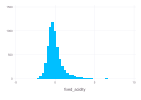

In [27]:
plot(df_norm, x = features[1], Geom.histogram(bincount=30))

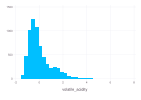

In [28]:
plot(df_norm, x = features[2], Geom.histogram(bincount=30))

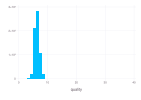

In [29]:
plot(df_norm, x = :quality, Geom.histogram(bincount=30))

In [30]:
plot(df_norm, x = features[1], y = :quality)

In [31]:
plot(df_norm, x = features[2], y = :quality)

In [32]:
plot(df_norm, x = features[3], y = :quality)

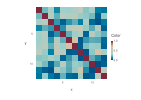

In [33]:
spy(abs.(cor(XY)))

In [34]:
cor(X[:, 6:7])

2×2 Array{Float64,2}:
 1.0       0.720934
 0.720934  1.0

In [35]:
plot(df_norm, x = features[6], y = features[7])

In [36]:
cor(X[:, [8,11]])

2×2 Array{Float64,2}:
  1.0       -0.686745
 -0.686745   1.0

In [37]:
plot(df_norm, x = features[8], y = features[11])

## Feature Selection

In [38]:
ind = setdiff((1:11), [7,8]) # features to keep

9-element Array{Int64,1}:
  1
  2
  3
  4
  5
  6
  9
 10
 11

In [39]:
nf -= 2

9

In [40]:
X_final = X_norm[:, ind];

In [41]:
y = map(Float64, Vector(df[:quality]));

In [42]:
df_final = DataFrame(hcat(X_final, y));

In [43]:
for i = 1:nf
    rename!(df_final, default_names[i] => original_names[ind][i])
end

In [44]:
rename!(df_final, default_names[nf+1] => :quality);

In [45]:
names(df_final)

10-element Array{Symbol,1}:
 :fixed_acidity
 :volatile_acidity
 :citric_acid
 :residual_sugar
 :chlorides
 :free_sulfur_dioxide
 :pH
 :sulphates
 :alcohol
 :quality

## Clustering

In [46]:
mnc = 9; # maximum number of clusters

In [47]:
D = pairwise(Euclidean(), X_final, dims=1)

6497×6497 Array{Float64,2}:
 0.0      4.83952     3.70866  …  6.41333  5.98026   6.5078   5.30378
 4.83952  0.0         2.14362     3.8029   3.19948   3.70334  2.13287
 3.70866  2.14362     0.0         4.3899   3.83664   4.48402  2.73342
 3.0404   2.6933      1.49991     4.50534  4.06244   4.69664  3.37716
 3.0404   2.6933      1.49991     4.50534  4.06244   4.69664  3.37716
 3.70866  2.14362     0.0      …  4.3899   3.83664   4.48402  2.73342
 3.61857  2.06177     2.32793     3.7088   3.20762   3.82286  3.26409
 0.0      4.83952     3.70866     6.41333  5.98026   6.5078   5.30378
 4.83952  2.98023e-8  2.14362     3.8029   3.19948   3.70334  2.13287
 4.84994  2.25651     1.46337     4.53578  3.97112   4.81459  2.6554
 5.3613   3.28072     2.95123  …  5.16172  4.45169   5.5863   3.39094
 4.22747  2.25304     1.52252     4.92345  4.22901   5.04248  3.11647
 5.07953  2.19384     2.1901      4.28341  3.5806    4.64556  2.425
 ⋮                             ⋱                     ⋮        
 6

In [48]:
println("K | Silhouette score")

for k = 2:mnc
    print(k, " | ")
    R = kmeans(X_final', k; maxiter=200)  
    println(mean(Clustering.silhouettes(R, D)))
end

K | Silhouette score
2 | 0.25913522218894336
3 | 0.19128720625698178
4 | 0.21560371068355322
5 | 0.17421043326016084
6 | 0.18114550352185918
7 | 0.17238339727305232
8 | 0.13239242538322116
9 | 0.14977287624881855


Clearly, for k = 2 we get the optimal clustering results

In [49]:
R = kmeans(X_final', 2; maxiter=200);

In [50]:
cl = assignments(R) # clustering labels

6497-element Array{Int64,1}:
 2
 2
 2
 2
 2
 2
 2
 2
 2
 2
 2
 2
 2
 ⋮
 1
 1
 1
 1
 1
 1
 1
 1
 1
 1
 1
 2

In [51]:
counts(R)

2-element Array{Int64,1}:
 1715
 4782

In [52]:
show((R.centers)')

[0.7849064608622152 1.1561927214336447 -0.34473925292508845 -0.591478606810553 0.9103284986446207 -0.8120973580024982 0.5359601831951663 0.8162351549496794 -0.0875034801319511; -0.2814961481343992 -0.4146529730779392 0.12363609760906062 0.21212584915936739 -0.32647707552813365 0.2912477977779767 -0.1922149130446865 -0.29273176301519993 0.03138194655506129]

Clearly, the most important factors for the distinction of the two clusters are fixed_acidity and alcohol level, with the most acidic and stronger wines residing in the second cluster

# Work the data using predictive ML models

### Training and Testing split

In [53]:
split_ratio = 0.8;

In [54]:
indexes = randperm(N);

In [55]:
N_training = round(Int64, split_ratio * N); # number of data points in training set

In [56]:
N_testing = N - N_training;

In [57]:
train = indexes[1:N_training];

In [58]:
test = indexes[(N_training+1):end];

## Regression models

In [59]:
n_subfeatures = 3;
n_folds = 5; # number of folds for the K-fold cross-validation later on

In [60]:
nfoldCV_forest(y, X_final, n_folds, n_subfeatures)


Fold 1
Mean Squared Error:     0.2315755904562666
Correlation Coeff:      0.8524778571753989
Coeff of Determination: 0.6949206519799394

Fold 2
Mean Squared Error:     0.26297169081709176
Correlation Coeff:      0.8288878218510316
Coeff of Determination: 0.657147133362963

Fold 3
Mean Squared Error:     0.2221365547046213
Correlation Coeff:      0.859592239475346
Coeff of Determination: 0.7093277877808112

Fold 4
Mean Squared Error:     0.2423973733326363
Correlation Coeff:      0.8526830427687736
Coeff of Determination: 0.6950413125215369

Fold 5
Mean Squared Error:     0.2420709310197237
Correlation Coeff:      0.8290746245906413
Coeff of Determination: 0.6661462498029322

Mean Coeff of Determination: 0.6845166270896366


5-element Array{Float64,1}:
 0.6949206519799394
 0.657147133362963
 0.7093277877808112
 0.6950413125215369
 0.6661462498029322

In [61]:
forest = build_forest(y[train], X_final[train,:], n_subfeatures);

In [62]:
yhat = apply_forest(forest, X_final[test,:])

1299-element Array{Float64,1}:
 6.329642857142857
 5.049999999999999
 5.115952380952381
 6.338571428571429
 5.736666666666666
 4.984444444444444
 5.198888888888889
 6.543333333333334
 6.3213888888888885
 5.8530014430014425
 5.296666666666667
 5.444325396825397
 6.247142857142856
 ⋮
 5.153968253968254
 6.219166666666666
 5.617460317460318
 5.2411111111111115
 5.5753571428571425
 5.925357142857143
 5.344444444444444
 6.401587301587301
 5.9625
 6.219880952380952
 6.691190476190476
 6.472619047619048

## Some data engineering before classification can take place

In [63]:
m = mean(y)

5.818377712790519

In [64]:
yy = Int64.(y .>= m); # good wines

In [65]:
sum(yy)

4113

In [66]:
N - sum(yy)

2384

## Classification models

In [67]:
tree = DecisionTreeClassifier(max_depth=3);

In [68]:
accuracy = cross_val_score(tree, X_final, yy, cv=5)

5-element Array{Float64,1}:
 0.6853846153846154
 0.71
 0.7253846153846154
 0.6882217090069284
 0.6032357473035439

In [69]:
tree2 = DecisionTreeClassifier(max_depth=5);

In [70]:
accuracy = cross_val_score(tree2, X_final, yy, cv=5)

5-element Array{Float64,1}:
 0.693076923076923
 0.72
 0.7346153846153847
 0.7036181678214011
 0.5600924499229584

In [71]:
tree3 = DecisionTreeClassifier(max_depth=7);

In [72]:
accuracy = cross_val_score(tree3, X_final, yy, cv=5)

5-element Array{Float64,1}:
 0.6984615384615385
 0.7161538461538461
 0.7353846153846154
 0.7582755966127791
 0.4938366718027735

In [73]:
accuracy = nfoldCV_forest(yy, X_final, n_folds, n_subfeatures) # n_subfeatures = 3


Fold 1
Classes:  

2×2 Array{Int64,2}:
 445    9
  22  823

[0, 1]
Matrix:   
Accuracy: 

2×2 Array{Int64,2}:
 448   11
  20  820

0.9761354888375674
Kappa:    0.9478612481760048

Fold 2
Classes:  [0, 1]
Matrix:   
Accuracy: 0.9761354888375674
Kappa:    0.9480097450258151


2×2 Array{Int64,2}:
 477   12
  20  790

2×2 Array{Int64,2}:
 463    7
  18  811


Fold 3
Classes:  [0, 1]
Matrix:   
Accuracy: 0.9753656658968437
Kappa:    0.9476966283652176

Fold 4
Classes:  [0, 1]
Matrix:   
Accuracy: 0.9807544264819091
Kappa:    0.9585359718797919


2×2 Array{Int64,2}:
 495   17
  19  768


Fold 5
Classes:  [0, 1]
Matrix:   
Accuracy: 0.9722863741339491
Kappa:    0.9420116611568402

Mean Accuracy: 0.9761354888375674


5-element Array{Float64,1}:
 0.9761354888375674
 0.9761354888375674
 0.9753656658968437
 0.9807544264819091
 0.9722863741339491

In [74]:
n_subfeatures = 5;

In [75]:
accuracy = nfoldCV_forest(yy, X_final, n_folds, n_subfeatures)

2×2 Array{Int64,2}:
 457    4
  18  820


Fold 1
Classes:  [0, 1]
Matrix:   
Accuracy: 0.9830638953040801
Kappa:    0.9632632913149783


2×2 Array{Int64,2}:
 445   14
  26  814


Fold 2
Classes:  [0, 1]
Matrix:   
Accuracy: 0.9692070823710547
Kappa:    0.9330146501446451


2×2 Array{Int64,2}:
 459   17
  15  808


Fold 3
Classes:  [0, 1]
Matrix:   
Accuracy: 0.9753656658968437
Kappa:    0.9468984494163275


2×2 Array{Int64,2}:
 488   21
  16  774


Fold 4
Classes:  [0, 1]
Matrix:   
Accuracy: 0.9715165511932256
Kappa:    0.9401319108387362


2×2 Array{Int64,2}:
 465   13
  19  802


Fold 5
Classes:  [0, 1]
Matrix:   
Accuracy: 0.9753656658968437
Kappa:    0.9471772728081389

Mean Accuracy: 0.9749037721324095


5-element Array{Float64,1}:
 0.9830638953040801
 0.9692070823710547
 0.9753656658968437
 0.9715165511932256
 0.9753656658968437

In [78]:
n_subfeatures = 4;

In [79]:
accuracy = nfoldCV_forest(yy, X_final, n_folds, n_subfeatures);

2×2 Array{Int64,2}:
 464   10
  25  800


Fold 1
Classes:  [0, 1]
Matrix:   
Accuracy: 0.9730561970746728
Kappa:    0.9422567678268656


2×2 Array{Int64,2}:
 450   14
  24  811


Fold 2
Classes:  [0, 1]
Matrix:   
Accuracy: 0.970746728252502
Kappa:    0.9366007783300583


2×2 Array{Int64,2}:
 447   16
  30  806


Fold 3
Classes:  [0, 1]
Matrix:   
Accuracy: 0.9645881447267128
Kappa:    0.9233292017275757


2×2 Array{Int64,2}:
 469   15
  26  789


Fold 4
Classes:  [0, 1]
Matrix:   
Accuracy: 0.968437259430331
Kappa:    0.9328013868964029


2×2 Array{Int64,2}:
 486   11
  17  785


Fold 5
Classes:  [0, 1]
Matrix:   
Accuracy: 0.9784449576597383
Kappa:    0.9544791231236343

Mean Accuracy: 0.9710546574287914


In [80]:
n_subfeatures = 2;

In [81]:
accuracy = nfoldCV_forest(yy, X_final, n_folds, n_subfeatures)

2×2 Array{Int64,2}:
 477   16
  26  780

2×2 Array{Int64,2}:
 472   25
  16  786


Fold 1
Classes:  [0, 1]
Matrix:   
Accuracy: 0.9676674364896074
Kappa:    0.9316183824948675

Fold 2
Classes:  [0, 1]
Matrix:   
Accuracy: 0.968437259430331
Kappa:    0.9329605774108399


2×2 Array{Int64,2}:
 427    8
  22  842

2×2 Array{Int64,2}:
 460   18
  24  797


Fold 3
Classes:  [0, 1]
Matrix:   
Accuracy: 0.976905311778291
Kappa:    0.948567084517861

Fold 4
Classes:  [0, 1]
Matrix:   
Accuracy: 0.9676674364896074
Kappa:    0.9306701705606824


2×2 Array{Int64,2}:
 467   14
  14  804


Fold 5
Classes:  [0, 1]
Matrix:   
Accuracy: 0.9784449576597383
Kappa:    0.953779056468543

Mean Accuracy: 0.971824480369515


5-element Array{Float64,1}:
 0.9676674364896074
 0.968437259430331
 0.976905311778291
 0.9676674364896074
 0.9784449576597383

# Conclusions

Some of the features of the dataset are somewhat correlated. Namely, free_sulfur_dioxide (feature 6) and total_sulfur_dioxide (feat. 7) as well as density (feat. 8) and alcohol (feat. 11). To mitigate the chances of overfitting and to reduce potential computational overhead, one feature from each one of these pairs is removed. We chose to keep the features most correlated with the quality variable (target).

Based on the structure of the dataset, as shown by the clustering process,there are three distinct groups of wines: the ones of low fixed acidity, low volatile acidity, and low sulphates level, and those for high fixed acidity and alcohol level. The other characteristics vary too, but not as much as to constitute discerning factors.

When it comes to predicting the quality of the wines based on a regression model, the results are good but not overwhelming. This goes on to show that a clear-cut mapping between the characteristics of a wine and its quality (based on an expert's view) does not exist. However, we can predict the quality with some accuracy (coefficient of determination = 0.69 or so), in a reliable manner.

Predicting the quality of the wines based on a classification model is more promising. By using the mean of the quality level as a theshold (below which a wine is considered bad and above which good), the target variable turns into a binary one (0 = bad wine, 1 = good wine). The overall accuracy rate in this case is quite good (mean accuracy = 97.5%) and stable (not much fluctuation on the 5-fold cross validation setting).

In both the regression and the classification cases, the random forest with 3 sub-features seemed to perform best. This was to be expected as it is an ensemble model.

# Sandbox

A place for you to experiment with the above dataset and methods, without making a mess of the whole notebook or disrupt its flow. It's much easier to maintain this section than keep track of various copies of this notebook.